In [53]:
!pip3 install ipympl


[notice] A new release of pip is available: 23.2.1 -> 24.1.2
[notice] To update, run: pip install --upgrade pip


In [54]:
import pandas as pd
import numpy as np

#Abrimos los df y guardamos en distintas variables
df_fst = pd.read_csv("embeddings_fst.csv")
fst=df_fst.iloc[:,:100]
df_fst_mod=pd.read_csv("mod_embeddings_fst.csv")
fst_mod=df_fst_mod.iloc[:,:100]
df_w2v = pd.read_csv("embeddings_w2v.csv")
w2v=df_w2v.iloc[:,:100]
df_w2v_mod = pd.read_csv("mod_embeddings_w2v.csv")
w2v_mod=df_w2v_mod.iloc[:,:100]





In [55]:
from sklearn.decomposition import PCA
#Escalamos
# fstScaled = StandardScaler().fit_transform(fst)
# fst_modScaled= StandardScaler().fit_transform(fst_mod)

#Asignamos 3 Componentes principales
pca = PCA(n_components=3)

#Los guardamos
principalComponents_fst = pca.fit_transform(fst)
principalDf_fst = pd.DataFrame(data = principalComponents_fst
             , columns = ['pc1', 'pc2','pc3'])

principalComponents_fst_mod = pca.fit_transform(fst_mod)
principalDf_fst_mod = pd.DataFrame(data = principalComponents_fst_mod
             , columns = ['pc1', 'pc2','pc3'])

principalComponents_w2v = pca.fit_transform(w2v)
principalDf_w2v = pd.DataFrame(data = principalComponents_w2v
             , columns = ['pc1', 'pc2','pc3'])

principalComponents_w2v_mod = pca.fit_transform(w2v_mod)
principalDf_w2v_mod = pd.DataFrame(data = principalComponents_w2v_mod
             , columns = ['pc1', 'pc2','pc3'])


#Sacamos las emociones de los df
emotion_fst = df_fst.iloc[:,100:101]
emotion_fst_unique=np.unique(emotion_fst)

emotion_fst_mod = df_fst_mod.iloc[:,100:101]
emotion_fst_mod_unique=np.unique(emotion_fst_mod)

emotion_w2v = df_w2v.iloc[:,100:101]
emotion_w2v_unique=np.unique(emotion_w2v)

emotion_w2v_mod = df_w2v.iloc[:,100:101]
emotion_w2v_mod_unique=np.unique(emotion_w2v_mod)
#Solo correr una vez, añade las emociones al DataFrame que tiene los Componentes principales
principalDf_fst.insert(3, "emotion", df_fst.iloc[:,100:101], True)

principalDf_fst_mod.insert(3, "emotion", df_fst_mod.iloc[:,100:101], True)

principalDf_w2v.insert(3, "emotion", df_w2v.iloc[:,100:101], True)

principalDf_w2v_mod.insert(3, "emotion", df_w2v_mod.iloc[:,100:101], True)

principalDf_w2v_mod


,pc1,pc2,pc3,emotion
0,0.470796,-0.474105,0.191728,anger
1,0.469947,-0.475700,0.191556,anger
2,0.467266,-0.476602,0.191350,anger
3,0.469718,-0.474039,0.189433,anger
4,0.467598,-0.477599,0.189455,anger
...,...,...,...,...
153084,-0.028816,0.006446,0.010205,trust
153085,-0.087681,0.129819,-0.217729,trust
153086,-0.034191,0.029965,0.009985,trust
153087,-0.063057,0.091554,0.412190,trust


In [56]:
!pip install plotly


[notice] A new release of pip is available: 23.2.1 -> 24.1.2
[notice] To update, run: pip install --upgrade pip


In [57]:
!pip install nbformat


[notice] A new release of pip is available: 23.2.1 -> 24.1.2
[notice] To update, run: pip install --upgrade pip


In [58]:
pip install "notebook>=5.3" "ipywidgets>=7.5"


[notice] A new release of pip is available: 23.2.1 -> 24.1.2
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


# Grafica de fst (Sin modular)

## 2D


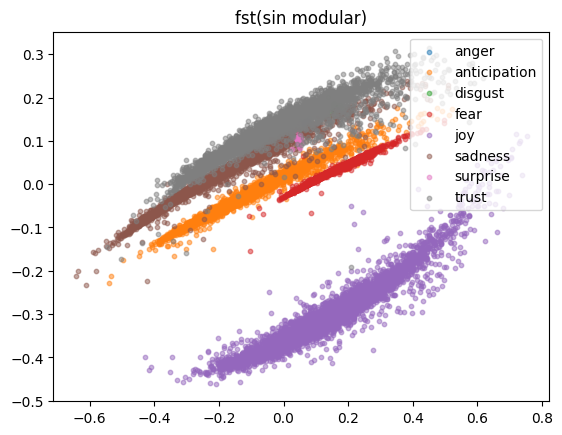

In [59]:
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
fig,ax = plt.subplots()

labels=emotion_fst_unique
for element in enumerate(emotion_fst_unique):
    data = principalDf_fst[principalDf_fst["emotion"]== element[1]]
    ax.scatter(data["pc1"],data["pc2"],label=emotion_fst_unique,s=10,alpha=0.5)

ax.legend(emotion_fst_unique)
#Descomentar para ajustar la resolucion de la grafica
#fig.set_dpi(500)
ax.title.set_text("fst(sin modular)")

## 3D

In [60]:
import plotly.express as px
fig = px.scatter_3d(principalDf_fst, x='pc1', y='pc2', z='pc3',
              color='emotion',opacity=0.5)
fig.update_traces(marker=dict(size=1))
fig.show()

# Grafica de fst ( Modulada )

## 2D

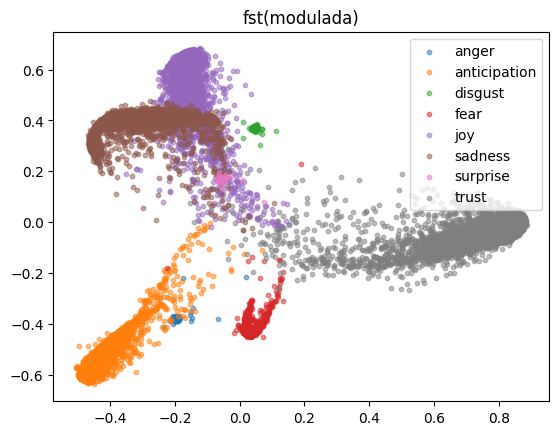

In [61]:
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
fig,ax = plt.subplots()

labels=emotion_fst_mod_unique
for element in enumerate(emotion_fst_mod_unique):
    data = principalDf_fst_mod[principalDf_fst_mod["emotion"]== element[1]]
    ax.scatter(data["pc1"],data["pc2"],label=emotion_fst_mod_unique,s=10,alpha=0.5)

ax.legend(emotion_fst_mod_unique)
#Descomentar para ajustar la resolucion de la grafica
#fig.set_dpi(500)
ax.title.set_text("fst(modulada)")

## 3D

In [62]:
import plotly.express as px
fig2 = px.scatter_3d(principalDf_fst_mod, x='pc1', y='pc2', z='pc3',
              color='emotion',opacity=0.5)
fig2.update_traces(marker=dict(size=1))
fig2.show()

# Grafica de W2V (Sin Modular)

## 2D

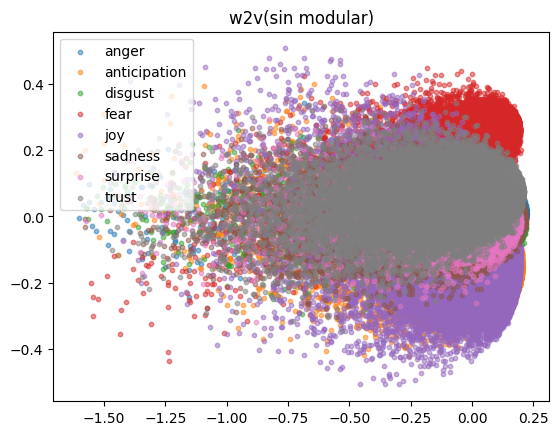

In [63]:
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
fig,ax = plt.subplots()

labels=emotion_w2v_unique
for element in enumerate(emotion_w2v_unique):
    data = principalDf_w2v[principalDf_w2v["emotion"]== element[1]]
    ax.scatter(data["pc1"],data["pc2"],label=emotion_w2v_unique,s=10,alpha=0.5)

ax.legend(emotion_w2v_unique)
#Descomentar para ajustar la resolucion de la grafica
#fig.set_dpi(500)
ax.title.set_text("w2v(sin modular)")

## 3D

In [64]:
import plotly.express as px
fig3 = px.scatter_3d(principalDf_w2v, x='pc1', y='pc2', z='pc3',
              color='emotion',opacity=0.5)
fig3.update_traces(marker=dict(size=1))
fig3.show()

# Grafica de w2v ( Modulada ) 

## 2D

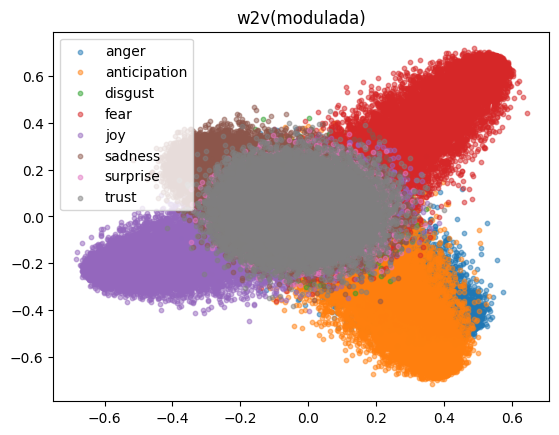

In [65]:
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
fig,ax = plt.subplots()

labels=emotion_w2v_mod_unique
for element in enumerate(emotion_w2v_mod_unique):
    data = principalDf_w2v_mod[principalDf_w2v_mod["emotion"]== element[1]]
    ax.scatter(data["pc1"],data["pc2"],label=emotion_w2v_mod_unique,s=10,alpha=0.5)

ax.legend(emotion_w2v_mod_unique)
#Descomentar para ajustar la resolucion de la grafica
#fig.set_dpi(500)
ax.title.set_text("w2v(modulada)")

## 3D

In [66]:
import plotly.express as px
fig4 = px.scatter_3d(principalDf_w2v_mod, x='pc1', y='pc2', z='pc3',
              color='emotion',opacity=0.5)
fig4.update_traces(marker=dict(size=1))
fig4.show()